#### IMPORTS

In [1]:
from utils.kernel import RBFKernel, LinearKernel, Matern52Kernel
from utils.gaussian_process import GaussianProcess as GP
import numpy as np
import pandas as pd
import scanpy as sc
import os
import scvelo as scv
import matplotlib.pyplot as plt
import random
random.seed(2020)
np.random.seed(2020)

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)

scanpy==1.4.5.post2 anndata==0.6.22.post1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==0.24.2 scikit-learn==0.22.1 statsmodels==0.11.0rc1 python-igraph==0.7.1 louvain==0.6.1


## Load Dataset

In [3]:
filename = "tgfb1-3-" + "control" + ".h5ad"
filename = os.path.join("write", filename)
anndata = sc.read_h5ad(filename)

### Dimensionality reductions

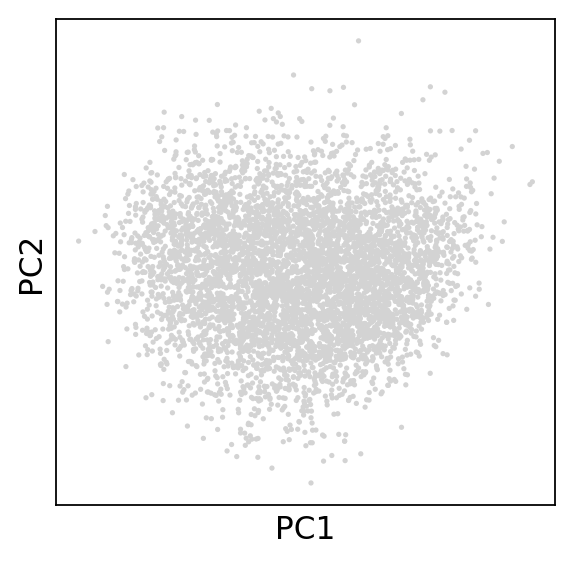

In [4]:
sc.pl.pca(anndata)

TGFB1 present in control batch :  True
Printing TGFB1 PCA plot for control batch


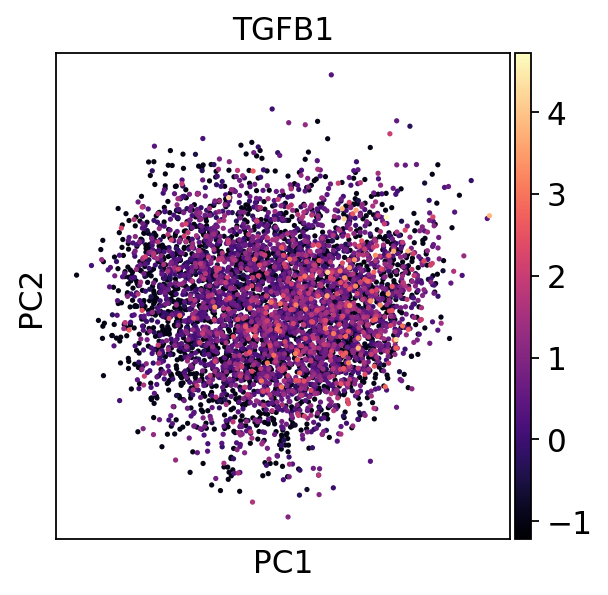

In [14]:
present = any(anndata.var.gene_names == "TGFB1")
print("TGFB1 present in control batch", ": ", present)

if present:
    print("Printing TGFB1 PCA plot for control batch")
    sc.pl.pca(anndata, color="TGFB1", color_map='magma')

In [15]:
print("Neighborhood graph calculation for control batch")
sc.pp.neighbors(anndata, n_neighbors=10, n_pcs=40)

Neighborhood graph calculation for control batch
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)


In [16]:
print("UMAP calculations for control batch")
sc.tl.umap(anndata)

UMAP calculations for control batch
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


### Velocity

In [17]:
#     scv.tl.recover_dynamics(anndata)
scv.tl.velocity(anndata, mode='stochastic')
scv.tl.velocity_graph(anndata)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:00) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:17) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [18]:
scv.tl.velocity_embedding(anndata, basis='umap')

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


### Top velocity genes

In [10]:
scv.tl.rank_velocity_genes(anndata, match_with='clusters', resolution=.4)

computing velocity clusters
    finished (0:00:03) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns)


In [11]:
pd.DataFrame(anndata.uns['rank_velocity_genes']['names'])

,0,1,2,3,4
0,GEM,DDAH1,EXT1,PSD3,SLC12A8
1,COL6A3,EFEMP1,PAPPA2,MAP4K4,RTKN2
2,CSGALNACT1,CALD1,FAM129A,TENM4,STK32A
3,EFNA5,COL12A1,SGCG,ZMIZ1,RND3
4,PRRX1,TPM1,AFAP1,SLC44A1,KCNMA1
5,GALNT1,MIR4435-2HG,TXNRD1,CA12,AKR1C1
6,COL14A1,LMO7,WARS,PLXNA4,CYTOR
7,RGS17,CRIM1,MSC-AS1,SVIL,AC105999.2
8,MDM2,MSRB3,FMN1,NRP1,CBLB
9,LAMA4,SEMA3C,KITLG,LTBP1,KCNE4


## Look at the spread of the data and the # of zero counts

Counts:  24291421
0s counts:  0
non 0s counts:  24291421
Sum:  -0.057949066
Mean:  -2.3855775e-09
Std:  0.9999062
Max:  25.881931
Min:  -13.268095



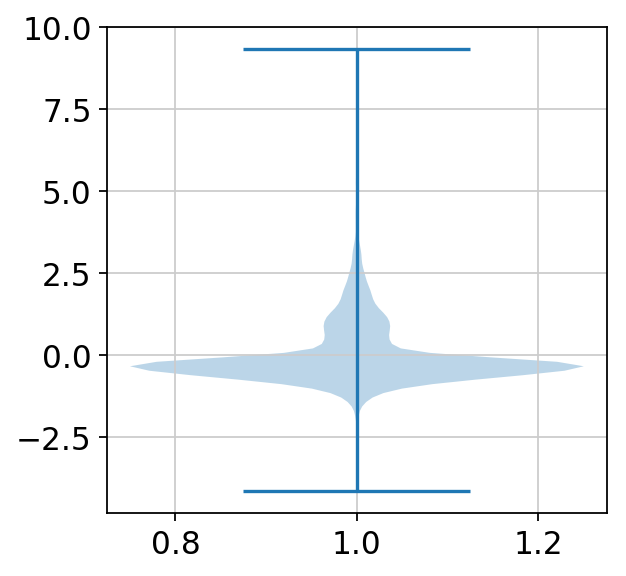

In [12]:
# statistics
data = anndata.X
print("Counts: ", data.shape[0] * data.shape[1])
print("0s counts: ", np.sum(data == 0.0)) 
print("non 0s counts: ", np.sum(data != 0.0))
print("Sum: ", np.sum(data[data != 0.0]))
print("Mean: ", np.mean(data[data != 0.0])) 
print("Std: ", np.std(data[data != 0.0]))
print("Max: ", np.max(data))
print("Min: ", np.min(data))
random_data = np.random.choice(np.ravel(data), 5000)
plt.violinplot(random_data)
print()

Mean:  0.010797180772953377
Std:  0.981370274094123
Max:  9.334679604974143
Min:  -4.140891547724464


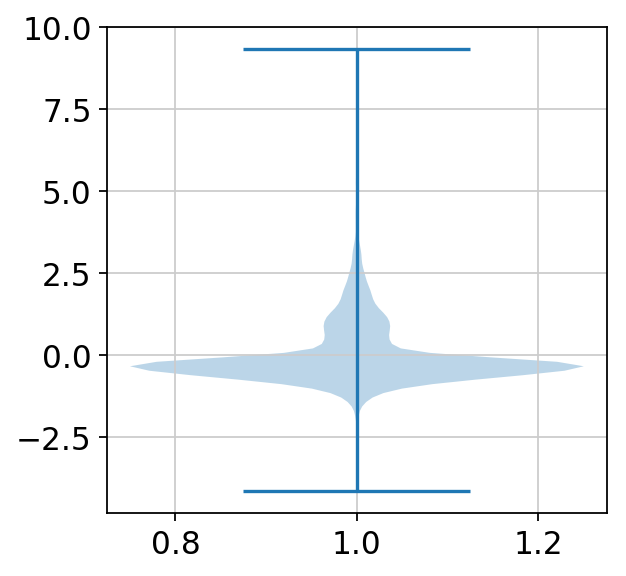

In [13]:
noiseless = random_data - np.random.randn(5000)*1e-8
plt.violinplot(noiseless)
print("Mean: ", np.mean(noiseless))
print("Std: ", np.std(noiseless))
print("Max: ", np.max(noiseless))
print("Min: ", np.min(noiseless))

In [14]:
def loss(true, pred, penalize_0s=True):
    error = np.square(true - pred)
    if not penalize_0s:
        error =  error[true != 0]
    return np.sqrt(np.mean(error))

# Baseline Gassian Process

    1. Using the RBF (Squared Exponent) Kernel
    2. 40% of dataset
    3. Optimize only for first gene in list

In [15]:
genes = {gene:i for i, gene in enumerate(list(anndata.var["velocity_genes"].index)) if anndata.var["velocity_genes"][gene]}
GENES = list(genes.keys())

In [16]:
kernel = RBFKernel(alpha=0.1, gamma=1)
gp = GP(kernel=kernel, optimize=True, restarts=0, alpha=1e-10)

In [17]:
mse_errors = []
X = anndata.obsm["X_umap"][:, :2]

In [18]:
#### Optimize for random gene
random_gene = np.random.choice(GENES)
print(random_gene)
y = anndata.X[:, genes[random_gene]].reshape(-1)
Y = y
gp.fit(X, Y.reshape(-1, 1), sample_ratio=0.4)
kernel.gamma

CRIM1


array([1., 1.])

In [19]:
#### Fit On All Genes
for gene in GENES:
    y = anndata.X[:, genes[gene]].reshape(-1)
    Y = y
    gp.fit(X, Y.reshape(-1, 1), sample_ratio=0.4)
    gp.log_marginal_likelihood(gene, info=True)
    pred = gp.predict(X)
    mse_errors.append(np.sqrt(np.sum((y - pred)**2)/X.shape[0]))

Gene: ABCA1        Marginal Likelihood: [-3053.3745691]
Gene: ABCA10       Marginal Likelihood: [-3044.8289718]
Gene: ABCA6        Marginal Likelihood: [-2988.89024835]
Gene: ABCA8        Marginal Likelihood: [-3016.73018442]
Gene: ABCC1        Marginal Likelihood: [-3049.78013521]
Gene: ABCC3        Marginal Likelihood: [-3103.29905962]
Gene: ABI3BP       Marginal Likelihood: [-3014.66811559]
Gene: AC003092.1   Marginal Likelihood: [-2996.60738543]
Gene: AC013652.1   Marginal Likelihood: [-3103.56492963]
Gene: AC083967.1   Marginal Likelihood: [-3020.02718406]
Gene: AC105999.2   Marginal Likelihood: [-3092.77613986]
Gene: AC109466.1   Marginal Likelihood: [-3035.13923862]
Gene: ACVR2A       Marginal Likelihood: [-2976.26460192]
Gene: ADAMTS12     Marginal Likelihood: [-3043.19032164]
Gene: ADAMTS6      Marginal Likelihood: [-3023.06231728]
Gene: ADAMTSL1     Marginal Likelihood: [-2999.08509337]
Gene: ADD3         Marginal Likelihood: [-3063.66390655]
Gene: ADGRL2       Marginal Likel

Gene: FAM180A      Marginal Likelihood: [-3090.78573955]
Gene: FAM20A       Marginal Likelihood: [-2972.52967452]
Gene: FAM20C       Marginal Likelihood: [-2985.99243036]
Gene: FANK1        Marginal Likelihood: [-3045.60932723]
Gene: FARP1        Marginal Likelihood: [-3029.04221605]
Gene: FBXO32       Marginal Likelihood: [-3139.76301399]
Gene: FGF14        Marginal Likelihood: [-3006.51375204]
Gene: FGF2         Marginal Likelihood: [-2700.1787618]
Gene: FGF9         Marginal Likelihood: [-2878.80276342]
Gene: FLRT2        Marginal Likelihood: [-2992.95168079]
Gene: FMN1         Marginal Likelihood: [-3008.73380051]
Gene: FMNL2        Marginal Likelihood: [-3004.7516662]
Gene: FN1          Marginal Likelihood: [-2987.51733249]
Gene: FNIP2        Marginal Likelihood: [-3061.72733695]
Gene: FRMD4A       Marginal Likelihood: [-2923.73447697]
Gene: FRMD6        Marginal Likelihood: [-2975.14016477]
Gene: FSIP1        Marginal Likelihood: [-2895.87327102]
Gene: FST          Marginal Likel

Gene: MN1          Marginal Likelihood: [-3119.00247955]
Gene: MOCOS        Marginal Likelihood: [-2993.67696132]
Gene: MRPS6        Marginal Likelihood: [-3048.9439268]
Gene: MSC-AS1      Marginal Likelihood: [-3066.29441933]
Gene: MSRB3        Marginal Likelihood: [-3015.75498673]
Gene: MTCL1        Marginal Likelihood: [-3075.34407536]
Gene: MTSS1        Marginal Likelihood: [-3021.55064592]
Gene: MXD1         Marginal Likelihood: [-3046.67418154]
Gene: MYH10        Marginal Likelihood: [-3081.7544813]
Gene: MYLIP        Marginal Likelihood: [-3112.41156857]
Gene: MYLK         Marginal Likelihood: [-3072.29619949]
Gene: MYO1B        Marginal Likelihood: [-3028.39945942]
Gene: NAMPT        Marginal Likelihood: [-3026.39403986]
Gene: NAV2         Marginal Likelihood: [-2944.83729934]
Gene: NAV3         Marginal Likelihood: [-2998.73629105]
Gene: NEK7         Marginal Likelihood: [-2720.75216192]
Gene: NEXN         Marginal Likelihood: [-3052.13626032]
Gene: NFIB         Marginal Likel

Gene: SLIT2        Marginal Likelihood: [-3004.04996067]
Gene: SLIT3        Marginal Likelihood: [-2791.53278046]
Gene: SMAD3        Marginal Likelihood: [-3056.4288028]
Gene: SMURF2       Marginal Likelihood: [-3001.71923148]
Gene: SMYD3        Marginal Likelihood: [-3097.57355422]
Gene: SNX9         Marginal Likelihood: [-2793.29950683]
Gene: SOBP         Marginal Likelihood: [-3090.14589919]
Gene: SOCS5        Marginal Likelihood: [-2756.89214295]
Gene: SOD2         Marginal Likelihood: [-3007.71264275]
Gene: SORBS2       Marginal Likelihood: [-2948.18737777]
Gene: SOX6         Marginal Likelihood: [-2966.30190299]
Gene: SPON1        Marginal Likelihood: [-3090.89071625]
Gene: SPSB1        Marginal Likelihood: [-3057.08549285]
Gene: SPTLC3       Marginal Likelihood: [-3108.55882228]
Gene: SQSTM1       Marginal Likelihood: [-3089.58363402]
Gene: SRGAP1       Marginal Likelihood: [-3043.32374919]
Gene: ST3GAL5      Marginal Likelihood: [-2976.50362582]
Gene: ST3GAL6      Marginal Like

### Rank Genes by Smoothness

Get top and last 10 genes by smoothness

In [20]:
lh = gp.get_all_likelihoods()
top = list(zip(*sorted(list(lh.items()), key=lambda x:x[1], reverse=True)))[0]
last = top[::-1]
top[:10]

('LMO7',
 'TXNRD1',
 'GLS',
 'TNFRSF11B',
 'FST',
 'TENM4',
 'ANKH',
 'SLC14A1',
 'CCDC80',
 'CALD1')

In [21]:
last[:10]

('KYNU',
 'ST6GALNAC5',
 'PCDH7',
 'TMEFF2',
 'IL1A',
 'LINC01705',
 'DRAXIN',
 'AFF2',
 'LINC02154',
 'LINC01423')

### Inspect Corelation Between Genes

Plot the correlation between top 3:

    1. smoothest and least smooth genes
    2. smoothest and smoothest genes
    3. lest smooth and leat smooth genes

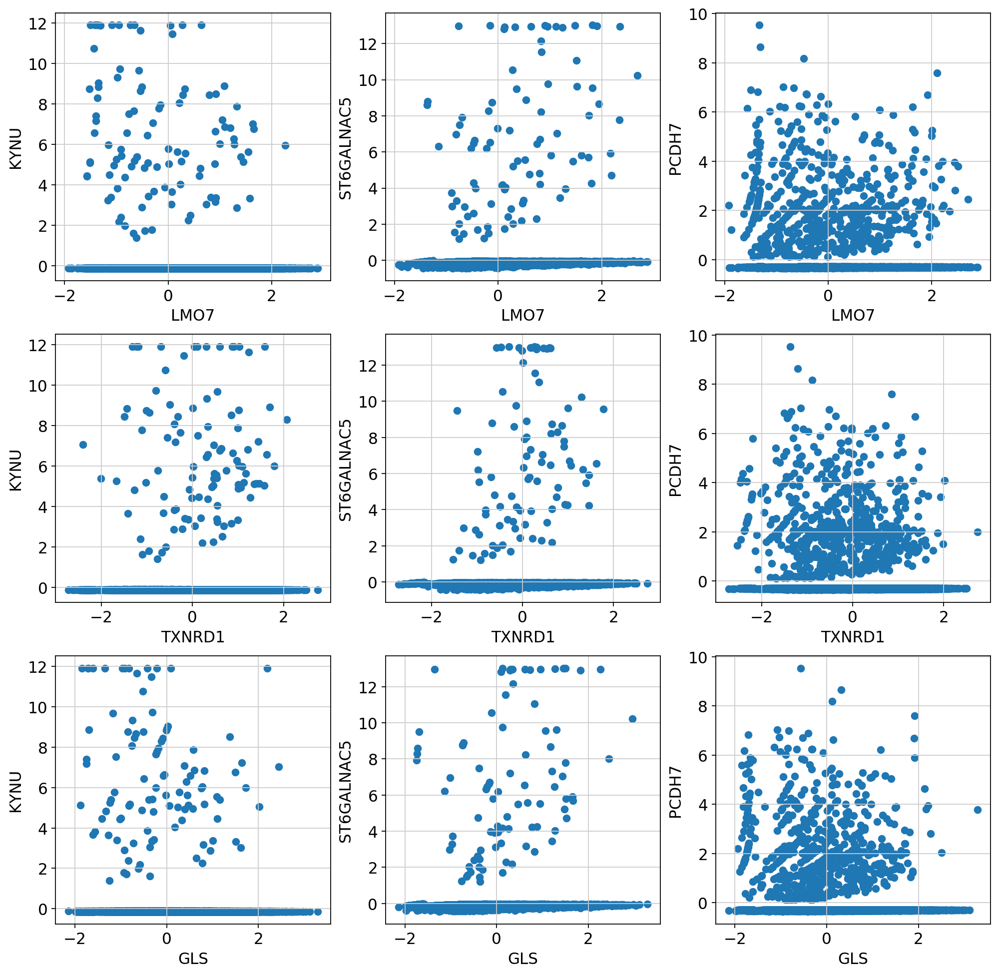

In [22]:
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, genei in enumerate(top[:3]):
    for j, genej in enumerate(last[:3]):
        ax[i][j].scatter(anndata.X[:, genes[genei]], anndata.X[:, genes[genej]])
        ax[i][j].set_xlabel(genei)
        ax[i][j].set_ylabel(genej)

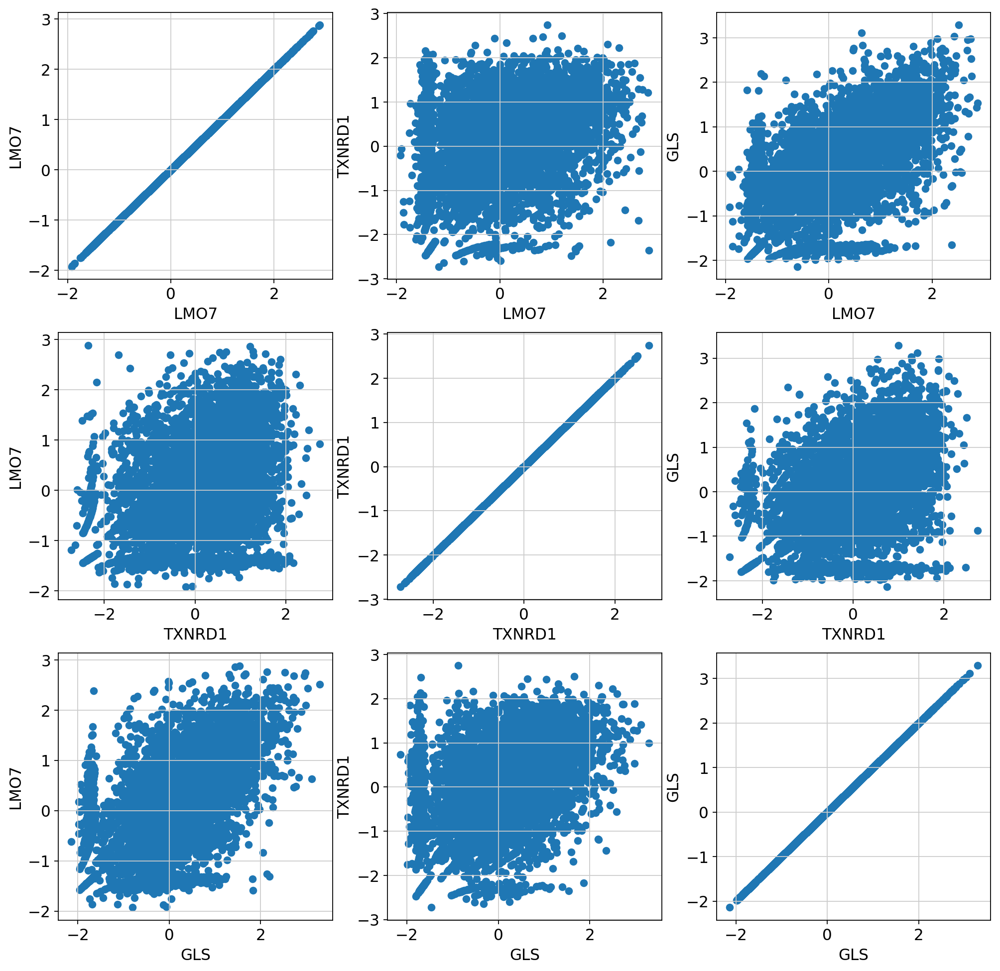

In [23]:
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, genei in enumerate(top[:3]):
    for j, genej in enumerate(top[:3]):
        ax[i][j].scatter(anndata.X[:, genes[genei]], anndata.X[:, genes[genej]])
        ax[i][j].set_xlabel(genei)
        ax[i][j].set_ylabel(genej)

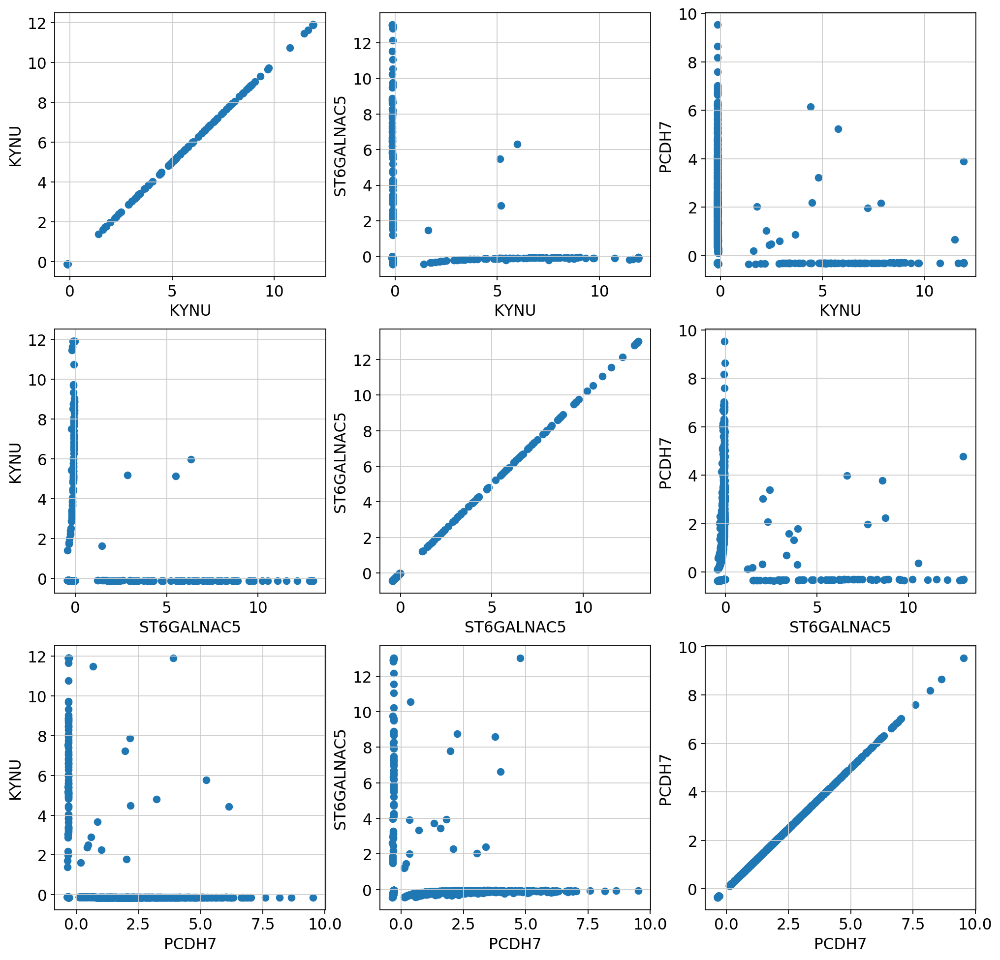

In [24]:
fig, ax = plt.subplots(3, 3, figsize=(15, 15))
for i, genei in enumerate(last[:3]):
    for j, genej in enumerate(last[:3]):
        ax[i][j].scatter(anndata.X[:, genes[genei]], anndata.X[:, genes[genej]])
        ax[i][j].set_xlabel(genei)
        ax[i][j].set_ylabel(genej)

## Gaussian Process with RNA Velocity Observations

Enhance the model by adding RNA Velocities

    1. Use only 20% of the dataset

In [25]:
kernel_do = RBFKernel(alpha=0.1, gamma=1)
gp_do = GP(kernel=kernel_do, derivative_observations=True, optimize=False)

In [26]:
errors_do = []
X = anndata.obsm["X_umap"][:, :2]
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]

In [27]:
#### Use the same gammas as in the baseline model
gp_do.gamma = gp.kernel.gamma

In [28]:
for gene in GENES:
    y = anndata.X[:, genes[gene]].reshape(-1)
    Y = np.hstack((y, dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    gp_do.log_marginal_likelihood(gene, info=True)
    pred = gp_do.predict(X)
    errors_do.append(np.sqrt(np.sum((y - pred)**2)/X.shape[0]))

Gene: ABCA1        Marginal Likelihood: [-1486.85813748]
Gene: ABCA10       Marginal Likelihood: [-1610.08583766]
Gene: ABCA6        Marginal Likelihood: [-1461.13998956]
Gene: ABCA8        Marginal Likelihood: [-1458.24090608]
Gene: ABCC1        Marginal Likelihood: [-1519.91489674]
Gene: ABCC3        Marginal Likelihood: [-1510.0976687]
Gene: ABI3BP       Marginal Likelihood: [-1452.30022116]
Gene: AC003092.1   Marginal Likelihood: [-1552.99433491]
Gene: AC013652.1   Marginal Likelihood: [-1540.16639557]
Gene: AC083967.1   Marginal Likelihood: [-1439.55472137]
Gene: AC105999.2   Marginal Likelihood: [-1620.79975116]
Gene: AC109466.1   Marginal Likelihood: [-1515.06485973]
Gene: ACVR2A       Marginal Likelihood: [-1470.13694979]
Gene: ADAMTS12     Marginal Likelihood: [-1546.58265254]
Gene: ADAMTS6      Marginal Likelihood: [-1499.81554275]
Gene: ADAMTSL1     Marginal Likelihood: [-1522.42485761]
Gene: ADD3         Marginal Likelihood: [-1511.67272537]
Gene: ADGRL2       Marginal Like

Gene: FAM20A       Marginal Likelihood: [-1482.03750883]
Gene: FAM20C       Marginal Likelihood: [-1469.82859686]
Gene: FANK1        Marginal Likelihood: [-1540.01373689]
Gene: FARP1        Marginal Likelihood: [-1484.76145616]
Gene: FBXO32       Marginal Likelihood: [-1566.18410446]
Gene: FGF14        Marginal Likelihood: [-1513.90870674]
Gene: FGF2         Marginal Likelihood: [-1325.91346168]
Gene: FGF9         Marginal Likelihood: [-1476.53079128]
Gene: FLRT2        Marginal Likelihood: [-1490.58468359]
Gene: FMN1         Marginal Likelihood: [-1524.16426594]
Gene: FMNL2        Marginal Likelihood: [-1481.65776517]
Gene: FN1          Marginal Likelihood: [-1513.95379875]
Gene: FNIP2        Marginal Likelihood: [-1522.43011288]
Gene: FRMD4A       Marginal Likelihood: [-1483.09661913]
Gene: FRMD6        Marginal Likelihood: [-1483.33799975]
Gene: FSIP1        Marginal Likelihood: [-1516.7743316]
Gene: FST          Marginal Likelihood: [-1349.70179782]
Gene: FUT8         Marginal Like

Gene: MRPS6        Marginal Likelihood: [-1518.47026513]
Gene: MSC-AS1      Marginal Likelihood: [-1551.98164798]
Gene: MSRB3        Marginal Likelihood: [-1510.7340559]
Gene: MTCL1        Marginal Likelihood: [-1500.86168429]
Gene: MTSS1        Marginal Likelihood: [-1491.7290421]
Gene: MXD1         Marginal Likelihood: [-1512.20955596]
Gene: MYH10        Marginal Likelihood: [-1487.03454419]
Gene: MYLIP        Marginal Likelihood: [-1538.1871671]
Gene: MYLK         Marginal Likelihood: [-1543.94237234]
Gene: MYO1B        Marginal Likelihood: [-1495.31646089]
Gene: NAMPT        Marginal Likelihood: [-1525.70022218]
Gene: NAV2         Marginal Likelihood: [-1486.63720936]
Gene: NAV3         Marginal Likelihood: [-1473.86909315]
Gene: NEK7         Marginal Likelihood: [-1371.16633246]
Gene: NEXN         Marginal Likelihood: [-1532.40493817]
Gene: NFIB         Marginal Likelihood: [-1505.25309212]
Gene: NGEF         Marginal Likelihood: [-1553.48549028]
Gene: NPAS2        Marginal Likeli

Gene: SMAD3        Marginal Likelihood: [-1516.59536966]
Gene: SMURF2       Marginal Likelihood: [-1470.62270533]
Gene: SMYD3        Marginal Likelihood: [-1476.68253254]
Gene: SNX9         Marginal Likelihood: [-1386.07423529]
Gene: SOBP         Marginal Likelihood: [-1501.41203325]
Gene: SOCS5        Marginal Likelihood: [-1382.6128032]
Gene: SOD2         Marginal Likelihood: [-1483.29001207]
Gene: SORBS2       Marginal Likelihood: [-1500.75268737]
Gene: SOX6         Marginal Likelihood: [-1505.70179356]
Gene: SPON1        Marginal Likelihood: [-1502.08820983]
Gene: SPSB1        Marginal Likelihood: [-1510.94110045]
Gene: SPTLC3       Marginal Likelihood: [-1573.51473674]
Gene: SQSTM1       Marginal Likelihood: [-1480.05519626]
Gene: SRGAP1       Marginal Likelihood: [-1503.27629914]
Gene: ST3GAL5      Marginal Likelihood: [-1592.92645973]
Gene: ST3GAL6      Marginal Likelihood: [-1506.60619116]
Gene: ST6GALNAC5   Marginal Likelihood: [-2171.53241358]
Gene: ST8SIA4      Marginal Like

In [29]:
lh_do = gp_do.get_all_likelihoods()
top_do = list(zip(*sorted(list(lh_do.items()), key=lambda x:x[1], reverse=True)))[0]
last_do = top_do[::-1]
top_do[:10]

('LMO7',
 'FGF2',
 'TNFRSF11B',
 'CALD1',
 'TXNRD1',
 'GLS',
 'ANKH',
 'FST',
 'SLC14A1',
 'GRAMD2B')

In [30]:
last_do[:10]

('ST6GALNAC5',
 'CHRM3',
 'NPY1R',
 'LINC02257',
 'ANKRD45',
 'LINC01013',
 'DRAXIN',
 'STK32A',
 'PRKG2',
 'TMEM132B')

## Gaussian Process with RBF + Linear Kernel

    1. Use 40% of the data

Check how RBF + Linear Kernel compares to the one with RNA Velocity observations

In [31]:
kernel_combined = RBFKernel(alpha=0.1, gamma=1) + LinearKernel(scale=0.5, sigma=0.0)
gp_combined = GP(kernel=kernel_combined, optimize=False)

In [32]:
errors_combined = []
X = anndata.obsm["X_umap"][:, :2]

In [33]:
#### Optimize for random gene
random_gene = np.random.choice(GENES)
print(random_gene)
y = anndata.X[:, genes[gene]].reshape(-1)
Y = y
gp_combined.fit(X, Y.reshape(-1, 1), sample_ratio=0.4)

TEAD1


In [34]:
for gene in GENES:
    y = anndata.X[:, genes[gene]].reshape(-1)
    Y = y
    gp_combined.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    gp_combined.log_marginal_likelihood(gene, info=True)
    pred = gp_combined.predict(X)
    errors_combined.append(np.sqrt(np.sum((y - pred)**2)/X.shape[0]))

Gene: ABCA1        Marginal Likelihood: [-5090.116487]
Gene: ABCA10       Marginal Likelihood: [-5154.21951225]
Gene: ABCA6        Marginal Likelihood: [-5033.3566927]
Gene: ABCA8        Marginal Likelihood: [-5080.79046121]
Gene: ABCC1        Marginal Likelihood: [-5166.05024852]
Gene: ABCC3        Marginal Likelihood: [-5214.77961599]
Gene: ABI3BP       Marginal Likelihood: [-5142.38292444]
Gene: AC003092.1   Marginal Likelihood: [-5116.41227897]
Gene: AC013652.1   Marginal Likelihood: [-5093.84601407]
Gene: AC083967.1   Marginal Likelihood: [-5180.43825807]
Gene: AC105999.2   Marginal Likelihood: [-5209.77983602]
Gene: AC109466.1   Marginal Likelihood: [-5158.95459361]
Gene: ACVR2A       Marginal Likelihood: [-5075.0778364]
Gene: ADAMTS12     Marginal Likelihood: [-5134.74773378]
Gene: ADAMTS6      Marginal Likelihood: [-5104.56714369]
Gene: ADAMTSL1     Marginal Likelihood: [-5077.07329993]
Gene: ADD3         Marginal Likelihood: [-5160.85321501]
Gene: ADGRL2       Marginal Likelih

Gene: FAM20A       Marginal Likelihood: [-5082.9142123]
Gene: FAM20C       Marginal Likelihood: [-5088.74952618]
Gene: FANK1        Marginal Likelihood: [-5147.15442772]
Gene: FARP1        Marginal Likelihood: [-5096.21277245]
Gene: FBXO32       Marginal Likelihood: [-5270.43728899]
Gene: FGF14        Marginal Likelihood: [-5018.20973101]
Gene: FGF2         Marginal Likelihood: [-4750.06530379]
Gene: FGF9         Marginal Likelihood: [-4944.38568237]
Gene: FLRT2        Marginal Likelihood: [-5063.68483015]
Gene: FMN1         Marginal Likelihood: [-5176.49335229]
Gene: FMNL2        Marginal Likelihood: [-5100.81723288]
Gene: FN1          Marginal Likelihood: [-5157.36748064]
Gene: FNIP2        Marginal Likelihood: [-5164.42467032]
Gene: FRMD4A       Marginal Likelihood: [-5022.57707664]
Gene: FRMD6        Marginal Likelihood: [-5059.77872036]
Gene: FSIP1        Marginal Likelihood: [-5143.06740201]
Gene: FST          Marginal Likelihood: [-4776.66838398]
Gene: FUT8         Marginal Like

Gene: MN1          Marginal Likelihood: [-5198.58697673]
Gene: MOCOS        Marginal Likelihood: [-5123.41822529]
Gene: MRPS6        Marginal Likelihood: [-5137.77823016]
Gene: MSC-AS1      Marginal Likelihood: [-5125.99521497]
Gene: MSRB3        Marginal Likelihood: [-5105.68135519]
Gene: MTCL1        Marginal Likelihood: [-5204.41615809]
Gene: MTSS1        Marginal Likelihood: [-5042.92275544]
Gene: MXD1         Marginal Likelihood: [-5176.6771639]
Gene: MYH10        Marginal Likelihood: [-5136.85327929]
Gene: MYLIP        Marginal Likelihood: [-5152.82708653]
Gene: MYLK         Marginal Likelihood: [-5125.54470904]
Gene: MYO1B        Marginal Likelihood: [-5062.82882463]
Gene: NAMPT        Marginal Likelihood: [-5122.41297339]
Gene: NAV2         Marginal Likelihood: [-5099.11167789]
Gene: NAV3         Marginal Likelihood: [-5102.08345216]
Gene: NEK7         Marginal Likelihood: [-4767.41330232]
Gene: NEXN         Marginal Likelihood: [-5101.45776721]
Gene: NFIB         Marginal Like

Gene: SLC8A1       Marginal Likelihood: [-5172.90654314]
Gene: SLIT2        Marginal Likelihood: [-5133.44427375]
Gene: SLIT3        Marginal Likelihood: [-4936.95679648]
Gene: SMAD3        Marginal Likelihood: [-5120.15152582]
Gene: SMURF2       Marginal Likelihood: [-5079.39998356]
Gene: SMYD3        Marginal Likelihood: [-5132.15485335]
Gene: SNX9         Marginal Likelihood: [-4868.08081452]
Gene: SOBP         Marginal Likelihood: [-5142.04430623]
Gene: SOCS5        Marginal Likelihood: [-4838.93637645]
Gene: SOD2         Marginal Likelihood: [-5057.96797438]
Gene: SORBS2       Marginal Likelihood: [-5008.47588225]
Gene: SOX6         Marginal Likelihood: [-5129.57185822]
Gene: SPON1        Marginal Likelihood: [-5190.43010425]
Gene: SPSB1        Marginal Likelihood: [-5179.1243149]
Gene: SPTLC3       Marginal Likelihood: [-5041.45417071]
Gene: SQSTM1       Marginal Likelihood: [-5223.44513845]
Gene: SRGAP1       Marginal Likelihood: [-5200.43024689]
Gene: ST3GAL5      Marginal Like

In [35]:
lh_combined = gp_combined.get_all_likelihoods()
top_combined = list(zip(*sorted(list(lh_combined.items()), key=lambda x:x[1], reverse=True)))[0]
last_combined = top_combined[::-1]
top_combined[:10]

('LMO7',
 'TXNRD1',
 'TNFRSF11B',
 'ANKH',
 'CALD1',
 'GLS',
 'FGF2',
 'TENM4',
 'NEK7',
 'CCDC80')

In [36]:
last_combined[:10]

('ST6GALNAC5',
 'DRAXIN',
 'CADM1',
 'EFNB2',
 'KCNJ3',
 'IL1B',
 'PNP',
 'PURPL',
 'LINC02154',
 'BMF')

## Look at smoothest genes

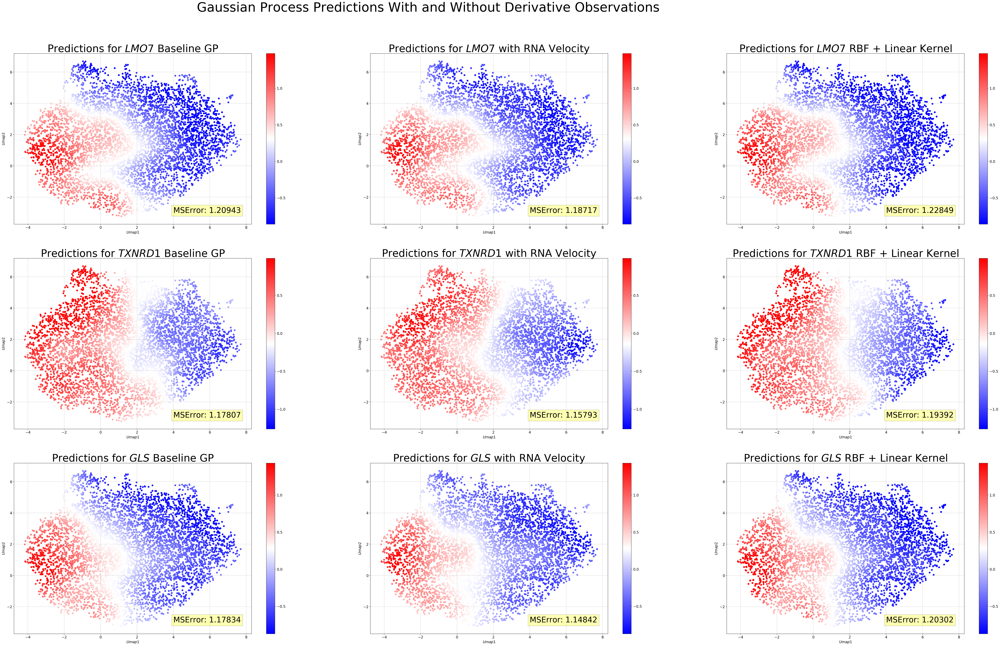

In [37]:
%matplotlib inline
fig, axs = plt.subplots(3, 3, figsize=(70,40))
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]
X = anndata.obsm["X_umap"][:, :2]

for i, gene in enumerate(top[:3]):

    y = anndata.X[:, genes[gene]].reshape(-1)
    gp.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred = gp.predict(X)
    gp_error = loss(y, pred)
    
    Y = np.hstack((y.reshape(-1), dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    pred_do = gp_do.predict(X)
    gp_do_error = loss(y, pred_do)

    gp_combined.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred_combined = gp_combined.predict(X)
    gp_combined_error = loss(y, pred_combined)
    
    _min, _max = min(pred_do), max(pred_do)

    p = axs[i][0].scatter(X[:, 0], X[:, 1],  c=pred.reshape(-1), vmin=_min, vmax=_max, cmap='bwr')
    axs[i][0].text(4, -3, 'MSError: {:.5f}'.format(gp_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][0].set_xlabel('$Umap1$')
    axs[i][0].set_ylabel('$Umap2$')
    axs[i][0].set_title("Predictions for ${gene}$ Baseline GP".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][0])

    p = axs[i][1].scatter(X[:, 0], X[:, 1],  c=pred_do.reshape(-1), vmin=_min, vmax=_max, cmap='bwr')
    axs[i][1].text(4, -3, 'MSError: {:.5f}'.format(gp_do_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][1].set_xlabel('$Umap1$')
    axs[i][1].set_ylabel('$Umap2$')
    axs[i][1].set_title("Predictions for ${gene}$ with RNA Velocity".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][1])
    

    p = axs[i][2].scatter(X[:, 0], X[:, 1],  c=pred_combined.reshape(-1), vmin=_min, vmax=_max, cmap='bwr')
    axs[i][2].text(4, -3, 'MSError: {:.5f}'.format(gp_combined_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][2].set_xlabel('$Umap1$')
    axs[i][2].set_ylabel('$Umap2$')
    axs[i][2].set_title("Predictions for ${gene}$ RBF + Linear Kernel".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][2])
    
#     scv.pl.velocity_embedding_grid(anndata, density = 0.4, basis='X_umap', color=gene, color_map="bwr",
#                                    size=300, alpha=0.3, arrow_length=3, arrow_size=2.3, colorbar=True,
#                                    show=False, ax=axs[i][3],
#                                    title="Actual values for ${gene}$ with RNA Velocity".format(gene=gene),
#                                    fontsize=20)
    
fig.suptitle("Gaussian Process Predictions With and Without Derivative Observations",  fontsize=50)   
fig.savefig("cardio_vascular_control_top_3_smoothest_genes_3_models.png", transparent=False)

# Analyse Genes Rankings For Each Model

In [38]:
genes = {key:idx for idx, key in enumerate(list(zip(*sorted(list(lh.items()), key=lambda x:x[1], reverse=True)))[0][:50])}
genes_do = {key:idx for idx, key in enumerate(list(zip(*sorted(list(lh_do.items()), key=lambda x:x[1], reverse=True)))[0])}
genes_combined = {key:idx for idx, key in enumerate(list(zip(*sorted(list(lh_combined.items()), key=lambda x:x[1], reverse=True)))[0])}

In [39]:
pos = {}
for key in genes.keys():
    pos[key] = genes[key] - genes_do[key]
    
print("GP vs GP + RNA Velocity".center(100))
print()
print("*********************************************************************************************".center(100))
print()
print("------------------------------------  UP  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p > 0])
print()
print("------------------------------------  DOWN  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p < 0])
print()
print("------------------------------------ UNCGANGED  ------------------------------------\n\n", [gene for gene, p in pos.items() if p == 0])

                                      GP vs GP + RNA Velocity                                       

   *********************************************************************************************    

------------------------------------  UP  ------------------------------------

 [('TNFRSF11B', 1), ('CALD1', 6), ('MEST', 1), ('FGF2', 11), ('VGLL3', 1), ('EXT1', 9), ('CRIM1', 6), ('SOCS5', 1), ('COL14A1', 2), ('GRAMD2B', 20), ('PDE1C', 1), ('SNX9', 9), ('CEMIP', 18), ('DMD', 7), ('GPR1', 7), ('DDAH1', 1), ('ALPK2', 19), ('LGALS3', 3)]

------------------------------------  DOWN  ------------------------------------

 [('TXNRD1', -3), ('GLS', -3), ('FST', -3), ('TENM4', -13), ('SLC14A1', -1), ('CCDC80', -3), ('WWTR1', -2), ('NEK7', -2), ('RGS7BP', -7), ('C1orf198', -22), ('MAP4K4', -9), ('TRIB3', -11), ('PSD3', -23), ('MCC', -21), ('LINC01411', -45), ('EFEMP1', -1), ('COL6A3', -10), ('CPXM2', -17), ('CYTOR', -1), ('SLIT3', -4), ('SVEP1', -2), ('HMGA2', -32), ('SVIL', -16), ('SLC20A1'

In [40]:
pos = {}
for key in genes.keys():
    pos[key] = genes[key] - genes_combined[key]
    
print("GP vs GP + Combined Kernel".center(100))
print()
print("*********************************************************************************************".center(100))
print()
print("------------------------------------  UP  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p > 200])
print()
print("------------------------------------  DOWN  ------------------------------------\n\n", [(gene, p) for gene, p in pos.items() if p < -200])
print()
print("------------------------------------ UNCGANGED  ------------------------------------\n\n", [gene for gene, p in pos.items() if p == 0])

                                     GP vs GP + Combined Kernel                                     

   *********************************************************************************************    

------------------------------------  UP  ------------------------------------

 []

------------------------------------  DOWN  ------------------------------------

 []

------------------------------------ UNCGANGED  ------------------------------------

 ['LMO7', 'TXNRD1', 'MEST', 'RGS7BP', 'TRIB3']


### Results from Mean Squared Error 

    1. GP vs GP + RNA Velocity: The value of t is -13.20413. The value of p is < .00001. 
    The result is significant at p < .05.

    2. GP vs GP + Combined Kernel: The value of t is 13.87756. The value of p is < .00001. 
    The result isignificant at p < .05.
        
    3. GP + RNA Velocity vs GP + Combined Kernel: The value of t is 19.027366. The value of p is < .00001. 
    The result is significant at p < .05.

# Analyse The Genes That Changed The Most

In [41]:
genes = {gene:i for i, gene in enumerate(list(anndata.var["velocity_genes"].index)) if anndata.var["velocity_genes"][gene]}
GENES = list(genes.keys())

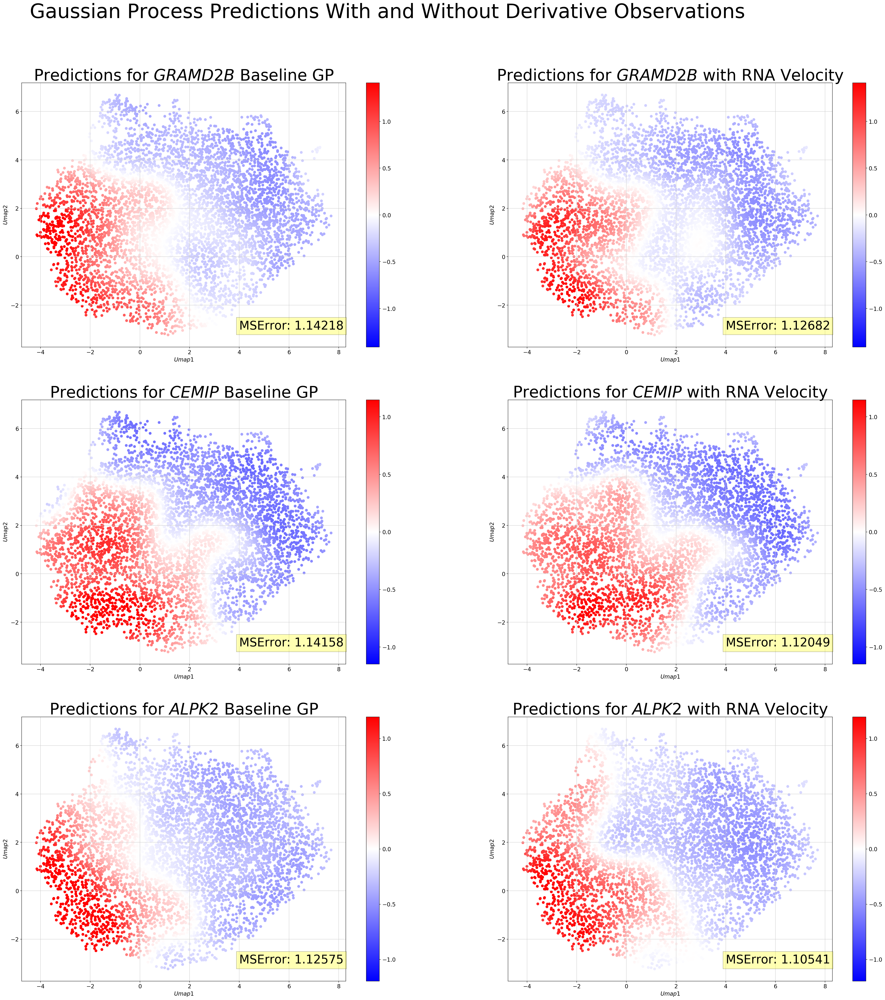

In [42]:
%matplotlib inline
fig, axs = plt.subplots(3, 2, figsize=(40,40))
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]
X = anndata.obsm["X_umap"][:, :2]

for i, gene in enumerate(["GRAMD2B", "CEMIP", "ALPK2"]):

    y = anndata.X[:, genes[gene]].reshape(-1)
    gp.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred = gp.predict(X)
    gp_error = loss(y, pred)
    
    Y = np.hstack((y.reshape(-1), dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    pred_do = gp_do.predict(X)
    gp_do_error = loss(y, pred_do)

    _min, _max = min(pred_do), max(pred_do)
    vmin, vmax = -_max, _max

    p = axs[i][0].scatter(X[:, 0], X[:, 1],  c=pred.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][0].text(4, -3, 'MSError: {:.5f}'.format(gp_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][0].set_xlabel('$Umap1$')
    axs[i][0].set_ylabel('$Umap2$')
    axs[i][0].set_title("Predictions for ${gene}$ Baseline GP".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][0])

    p = axs[i][1].scatter(X[:, 0], X[:, 1],  c=pred_do.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][1].text(4, -3, 'MSError: {:.5f}'.format(gp_do_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    
    axs[i][1].set_xlabel('$Umap1$')
    axs[i][1].set_ylabel('$Umap2$')
    axs[i][1].set_title("Predictions for ${gene}$ with RNA Velocity".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][1])
    
fig.suptitle("Gaussian Process Predictions With and Without Derivative Observations",  fontsize=50)   
fig.savefig("cardio_vascular_control_changed_genes_up.png", transparent=False)

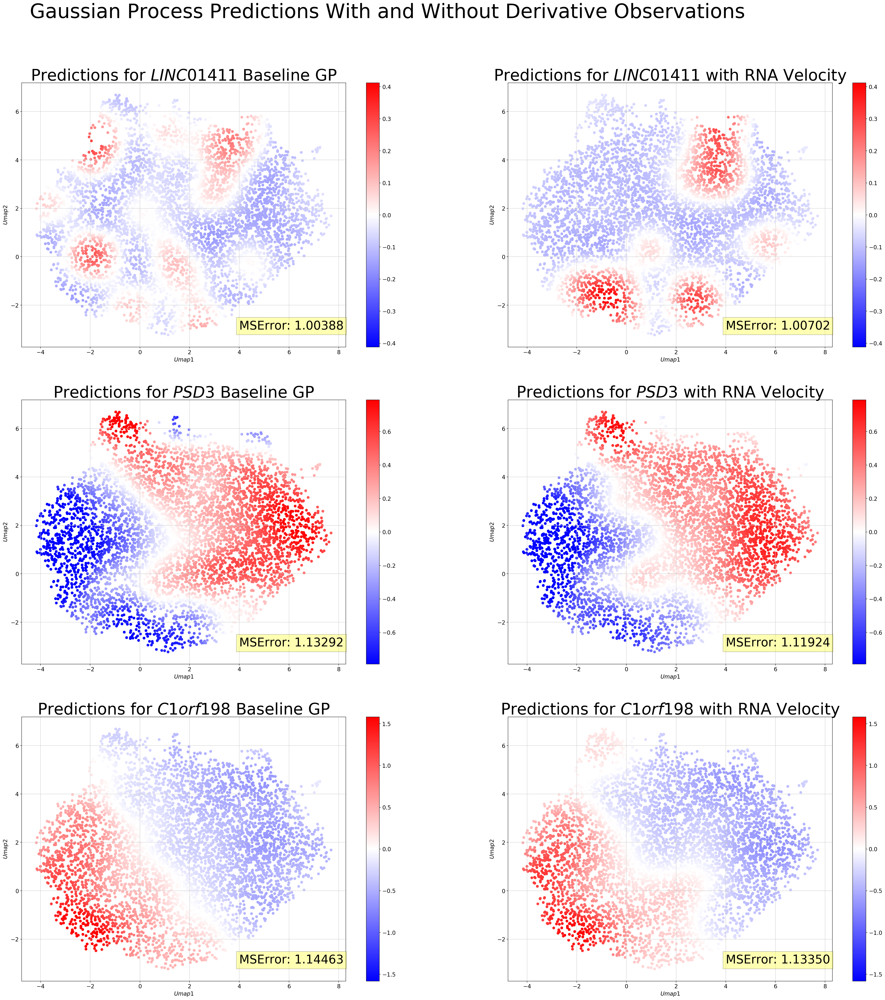

In [44]:
%matplotlib inline
fig, axs = plt.subplots(3, 2, figsize=(40,40))
dy_x1 = anndata.obsm["velocity_umap"][:, 0]
dy_x2 = anndata.obsm["velocity_umap"][:, 1]
X = anndata.obsm["X_umap"][:, :2]

for i, gene in enumerate(['LINC01411', "PSD3", "C1orf198"]):

    y = anndata.X[:, genes[gene]].reshape(-1)
    gp.fit(X, y.reshape(-1, 1), sample_ratio=0.4)
    pred = gp.predict(X)
    gp_error = loss(y, pred)
    
    Y = np.hstack((y.reshape(-1), dy_x1, dy_x2))
    gp_do.fit(X, Y.reshape(-1, 1), sample_ratio=0.2)
    pred_do = gp_do.predict(X)
    gp_do_error = loss(y, pred_do)

    _min, _max = min(pred_do), max(pred_do)
    vmin, vmax = -_max, _max

    p = axs[i][0].scatter(X[:, 0], X[:, 1],  c=pred.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][0].text(4, -3, 'MSError: {:.5f}'.format(gp_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    axs[i][0].set_xlabel('$Umap1$')
    axs[i][0].set_ylabel('$Umap2$')
    axs[i][0].set_title("Predictions for ${gene}$ Baseline GP".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][0])

    p = axs[i][1].scatter(X[:, 0], X[:, 1],  c=pred_do.reshape(-1), vmin=vmin, vmax=vmax, cmap='bwr')
    axs[i][1].text(4, -3, 'MSError: {:.5f}'.format(gp_do_error),
        bbox={'facecolor': 'yellow', 'alpha': 0.3, 'pad': 7}, fontsize=30)
    
    axs[i][1].set_xlabel('$Umap1$')
    axs[i][1].set_ylabel('$Umap2$')
    axs[i][1].set_title("Predictions for ${gene}$ with RNA Velocity".format(gene=gene), fontsize=40)
    fig.colorbar(p, ax=axs[i][1])
    
fig.suptitle("Gaussian Process Predictions With and Without Derivative Observations",  fontsize=50)   
fig.savefig("cardio_vascular_control_control_genes_down.png", transparent=False)

# Compare Identified Genes by Models to Highly Variable Genes

In [121]:
sc.pp.highly_variable_genes(anndata)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [132]:
higly_variable = [gene for gene in anndata.var["highly_variable"].index if anndata.var["highly_variable"][gene]]

In [128]:
higly_variable

['ABCA1',
 'ABCA10',
 'ABCB10',
 'ABCC4',
 'ABHD17C',
 'ABHD18',
 'ABHD3',
 'ABLIM1',
 'ABTB2',
 'AC002378.1',
 'AC003092.1',
 'AC005332.4',
 'AC006030.1',
 'AC006978.2',
 'AC007038.2',
 'AC007405.3',
 'AC007513.1',
 'AC007923.4',
 'AC007952.4',
 'AC009226.1',
 'AC012668.3',
 'AC013271.1',
 'AC018754.1',
 'AC018816.1',
 'AC020559.1',
 'AC021231.1',
 'AC021752.1',
 'AC022217.2',
 'AC025171.4',
 'AC026347.1',
 'AC026471.4',
 'AC027031.2',
 'AC037486.1',
 'AC053527.1',
 'AC068282.1',
 'AC068992.1',
 'AC074032.1',
 'AC078923.1',
 'AC079594.2',
 'AC084337.2',
 'AC087477.2',
 'AC090517.4',
 'AC092171.5',
 'AC092691.1',
 'AC092807.3',
 'AC093627.6',
 'AC097103.2',
 'AC097376.2',
 'AC099066.2',
 'AC100849.1',
 'AC105052.3',
 'AC107204.1',
 'AC108067.1',
 'AC112229.3',
 'AC114763.1',
 'AC124312.1',
 'AC135050.3',
 'AC138512.1',
 'AC239809.3',
 'AC244131.2',
 'ACACB',
 'ACTL6A',
 'ACTR3B',
 'ADAM32',
 'ADAMTS2',
 'ADAMTS3',
 'ADAMTS9-AS2',
 'ADARB1',
 'ADGRA2',
 'ADNP2',
 'ADTRP',
 'AF165147.1',

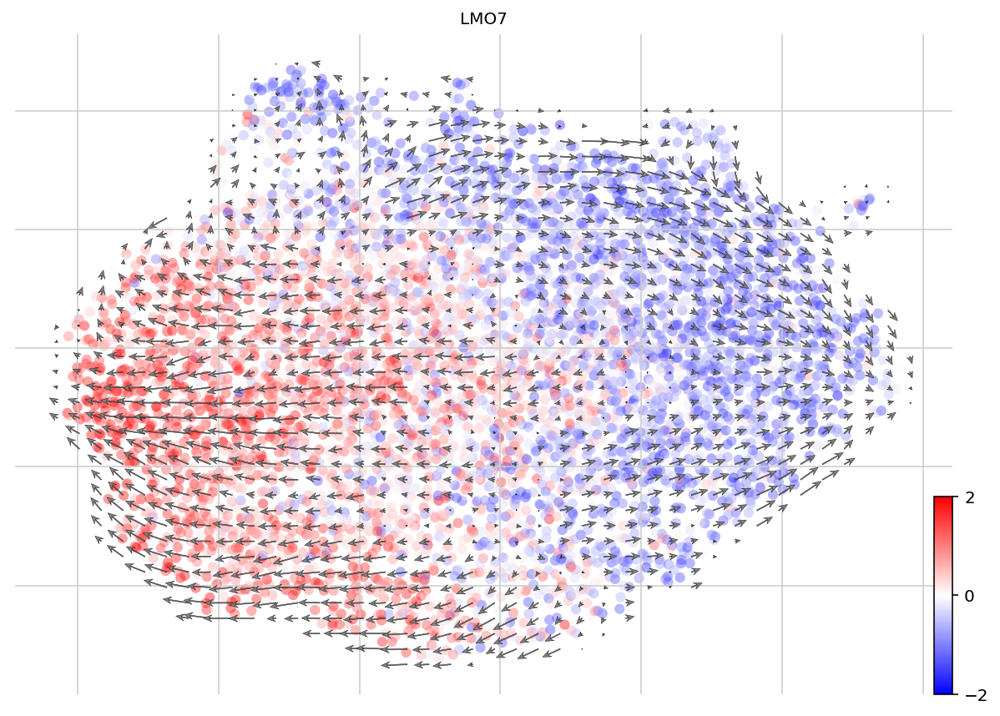

In [49]:
scv.pl.velocity_embedding_grid(anndata, basis='umap', figsize=(10, 7), alpha=0.4, arrow_length=2.5, density=0.8, size=150,
                               arrow_size=1.5, color="LMO7", color_map="bwr", vmin=-2, vmax=2)